In [1]:
import os
os.environ["CUDA_VISIBLE_DEVICES"] = "1"
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline
from __future__ import print_function
import keras
from keras.preprocessing.image import ImageDataGenerator, load_img 
import cv2
import glob
import os
from keras.models import Model
from keras.models import load_model

/home/ubuntu/.pyenv/versions/3.5.5/envs/recycle/lib/python3.5/site-packages/h5py/__init__.py:36: FutureWarning: Conversion of the second argument of issubdtype from `float` to `np.floating` is deprecated. In future, it will be treated as `np.float64 == np.dtype(float).type`.
  from ._conv import register_converters as _register_converters
Using TensorFlow backend.


In [2]:
train_dir = './new-dataset/train'
validation_dir = './new-dataset/validation'
test_dir = './new-dataset/test'
image_size = 224

## Experiment 3 : Train last 4 layers with data augmentation


In [3]:
from keras.applications import VGG16

#Load the VGG model
vgg_conv = VGG16(weights='imagenet', include_top=False, input_shape=(image_size, image_size, 3))

# Freeze all the layers
for layer in vgg_conv.layers[:-2 ]:
    layer.trainable = False

# Check the trainable status of the individual layers
for layer in vgg_conv.layers:
    print(layer, layer.trainable)


from keras import models
from keras import layers
from keras import optimizers

# Create the model
model = models.Sequential()

# Add the vgg convolutional base model
model.add(vgg_conv)

# Add new layers
model.add(layers.Flatten())
model.add(layers.Dense(128  , activation='relu'))
model.add(layers.Dropout(0.8))
model.add(layers.Dense(7 , activation='softmax'))

# Show a summary of the model. Check the number of trainable parameters
model.summary()

<keras.engine.topology.InputLayer object at 0x7f3cbad65fd0> False
<keras.layers.convolutional.Conv2D object at 0x7f3cbad67320> False
<keras.layers.convolutional.Conv2D object at 0x7f3cbad67128> False
<keras.layers.pooling.MaxPooling2D object at 0x7f3cbad67a20> False
<keras.layers.convolutional.Conv2D object at 0x7f3cbad05240> False
<keras.layers.convolutional.Conv2D object at 0x7f3cbad1b978> False
<keras.layers.pooling.MaxPooling2D object at 0x7f3cbacd12e8> False
<keras.layers.convolutional.Conv2D object at 0x7f3cbacc0358> False
<keras.layers.convolutional.Conv2D object at 0x7f3cbace2e48> False
<keras.layers.convolutional.Conv2D object at 0x7f3cbac73fd0> False
<keras.layers.pooling.MaxPooling2D object at 0x7f3cbac857f0> False
<keras.layers.convolutional.Conv2D object at 0x7f3cbac395c0> False
<keras.layers.convolutional.Conv2D object at 0x7f3cbac39f28> False
<keras.layers.convolutional.Conv2D object at 0x7f3cbac60fd0> False
<keras.layers.pooling.MaxPooling2D object at 0x7f3cba9d1cc0> Fa

## Experiment 3
Train the model. Here we will be using the imageDataGenerator for data augmentation.

Found 43612 images belonging to 7 classes.
Found 10896 images belonging to 7 classes.
Epoch 1/20
1745/1744 [==============================] - 895s 513ms/step - loss: 0.6053 - acc: 0.8148 - val_loss: 2.7844 - val_acc: 0.5936
Epoch 2/20
1745/1744 [==============================] - 888s 509ms/step - loss: 0.6033 - acc: 0.8147 - val_loss: 2.7124 - val_acc: 0.5940
Epoch 3/20
1745/1744 [==============================] - 890s 510ms/step - loss: 0.6104 - acc: 0.8137 - val_loss: 2.7867 - val_acc: 0.5876
Epoch 4/20
1745/1744 [==============================] - 883s 506ms/step - loss: 0.6216 - acc: 0.8131 - val_loss: 2.6314 - val_acc: 0.5978
Epoch 5/20
1745/1744 [==============================] - 891s 510ms/step - loss: 0.6112 - acc: 0.8134 - val_loss: 2.5898 - val_acc: 0.5953
Epoch 6/20
1745/1744 [==============================] - 889s 509ms/step - loss: 0.6324 - acc: 0.8086 - val_loss: 2.6841 - val_acc: 0.5898
Epoch 7/20
1745/1744 [==============================] - 888s 509ms/step - loss: 0.6275

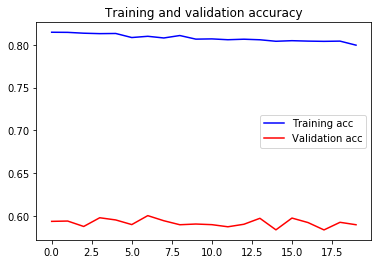

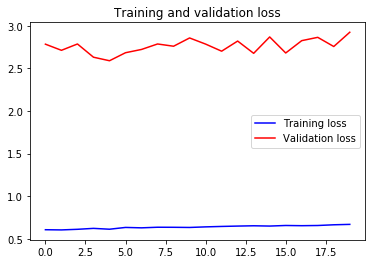

In [12]:
train_datagen = ImageDataGenerator(
      rescale=1./255,
      rotation_range=90,
      width_shift_range=0.2,
      height_shift_range=0.2,
      shear_range=0.2,
      zoom_range=0.2,
      horizontal_flip=True,
      fill_mode='nearest')

validation_datagen = ImageDataGenerator(rescale=1./255)

# Change the batchsize according to your system RAM
train_batchsize = 50
val_batchsize = 10

# Data Generator for Training data
train_generator = train_datagen.flow_from_directory(
        train_dir,
        target_size=(image_size, image_size),
        batch_size=train_batchsize,
        class_mode='categorical')

# Data Generator for Validation data
validation_generator = validation_datagen.flow_from_directory(
        validation_dir,
        target_size=(image_size, image_size),
        batch_size=val_batchsize,
        class_mode='categorical',
        shuffle=False)

# Compile the model
model.compile(loss='categorical_crossentropy',
              optimizer=optimizers.RMSprop(lr=1e-5),
              metrics=['acc'])

#model = load_model('da_last4_layers.h5')

# Train the Model
# NOTE that we have multiplied the steps_per_epoch by 2. This is because we are using data augmentation.
history = model.fit_generator(
      train_generator,
      steps_per_epoch=2*train_generator.samples/train_generator.batch_size ,
      epochs=20,
      validation_data=validation_generator,
      validation_steps=validation_generator.samples/validation_generator.batch_size,
      verbose=1)

# Save the Model
model.save('da_last4_layers.h5')

# Plot the accuracy and loss curves
acc = history.history['acc']
val_acc = history.history['val_acc']
loss = history.history['loss']
val_loss = history.history['val_loss']

epochs = range(len(acc))

plt.plot(epochs, acc, 'b', label='Training acc')
plt.plot(epochs, val_acc, 'r', label='Validation acc')
plt.title('Training and validation accuracy')
plt.legend()

plt.figure()

plt.plot(epochs, loss, 'b', label='Training loss')
plt.plot(epochs, val_loss, 'r', label='Validation loss')
plt.title('Training and validation loss')
plt.legend()
4
plt.show()

In [ ]:
train_datagen = ImageDataGenerator(
      rescale=1./255,
      rotation_range=90,
      width_shift_range=0.2,
      height_shift_range=0.2,
      shear_range=0.2,
      zoom_range=0.2,
      horizontal_flip=True,
      fill_mode='nearest')

validation_datagen = ImageDataGenerator(rescale=1./255)

# Change the batchsize according to your system RAM
train_batchsize = 100
val_batchsize = 10

# Data Generator for Training data
train_generator = train_datagen.flow_from_directory(
        train_dir,
        target_size=(image_size, image_size),
        batch_size=train_batchsize,
        class_mode='categorical')

# Data Generator for Validation data
validation_generator = validation_datagen.flow_from_directory(
        validation_dir,
        target_size=(image_size, image_size),
        batch_size=val_batchsize,
        class_mode='categorical',
        shuffle=False)

# Compile the model
model.compile(loss='categorical_crossentropy',
              optimizer=optimizers.RMSprop(lr=0.00005),
              metrics=['acc'])

# Train the Model
# NOTE that we have multiplied the steps_per_epoch by 2. This is because we are using data augmentation.
history = model.fit_generator(
      train_generator,
      steps_per_epoch=2*train_generator.samples/train_generator.batch_size ,
      epochs=40,
      validation_data=validation_generator,
      validation_steps=validation_generator.samples/validation_generator.batch_size,
      verbose=1)

# Save the Model
model.save('da_last4_layers.h5')

# Plot the accuracy and loss curves
acc = history.history['acc']
val_acc = history.history['val_acc']
loss = history.history['loss']
val_loss = history.history['val_loss']

epochs = range(len(acc))

plt.plot(epochs, acc, 'b', label='Training acc')
plt.plot(epochs, val_acc, 'r', label='Validation acc')
plt.title('Training and validation accuracy')
plt.legend()

plt.figure()

plt.plot(epochs, loss, 'b', label='Training loss')
plt.plot(epochs, val_loss, 'r', label='Validation loss')
plt.title('Training and validation loss')
plt.legend()
4
plt.show()

Found 21915 images belonging to 7 classes.
Found 5567 images belonging to 7 classes.
Epoch 1/40
 73/438 [===>..........................] - ETA: 5:53 - loss: 1.8288 - acc: 0.2668

In [5]:
#model.save('final_75.h5')
model = load_model('da_last4_layers.h5')

## Experiment 3
Show the errors

Found 10896 images belonging to 7 classes.
{'Tube': 6, 'Carton': 0, 'Metal': 1, 'NonRecyclablePlastic': 2, 'Tissue': 5, 'Paper': 3, 'RecyclablePlastic': 4}
1090/1089 [==============================] - 75s 69ms/step
No of errors = 4471/10896


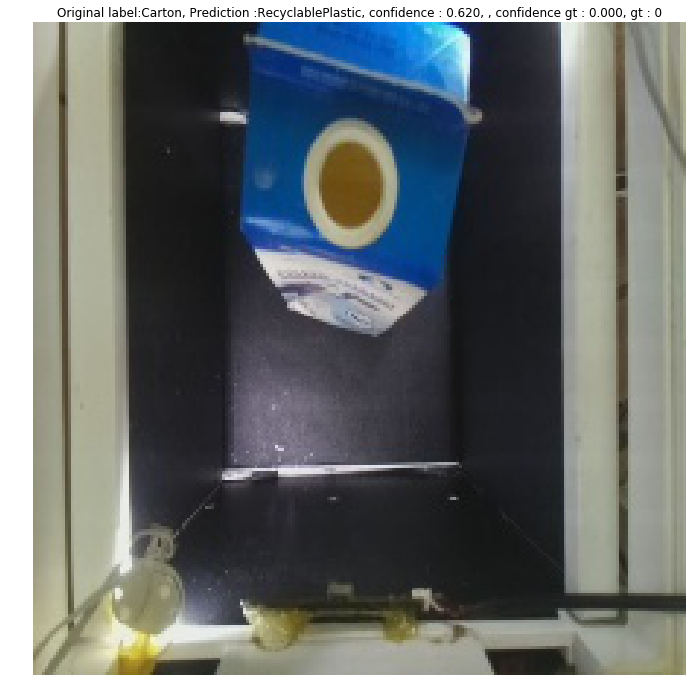

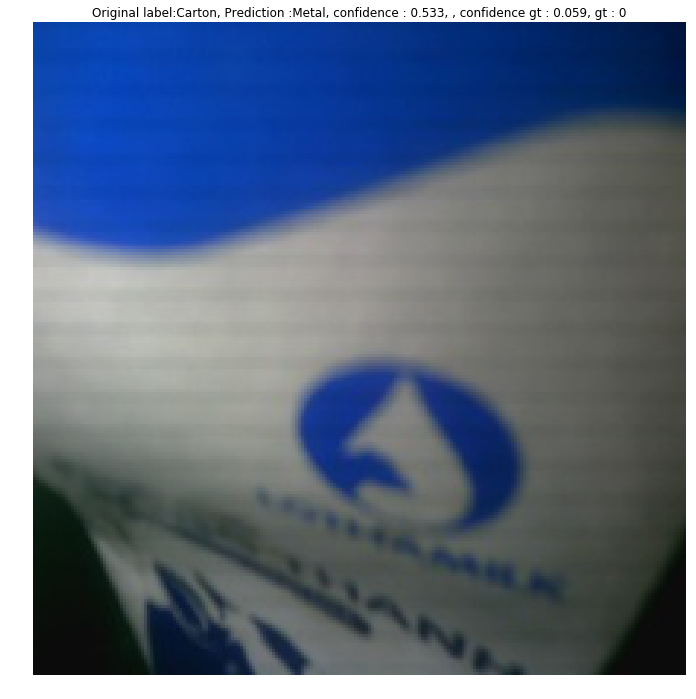

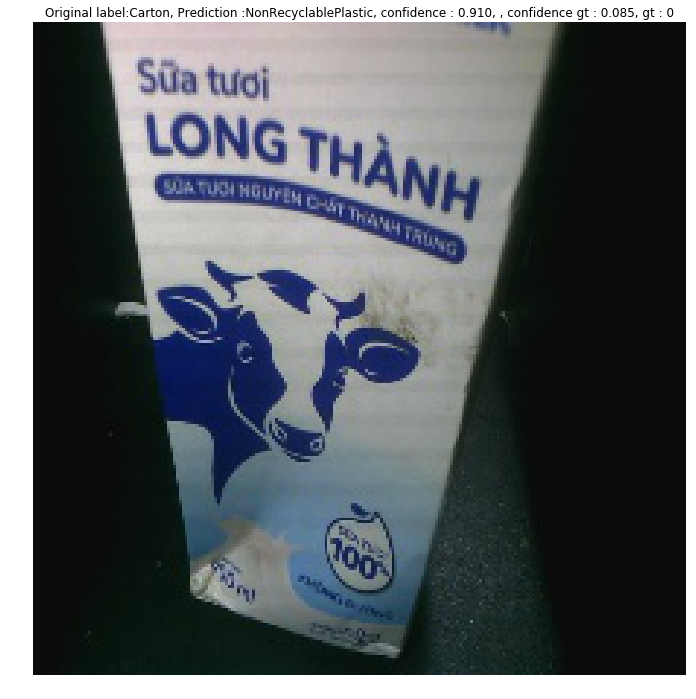

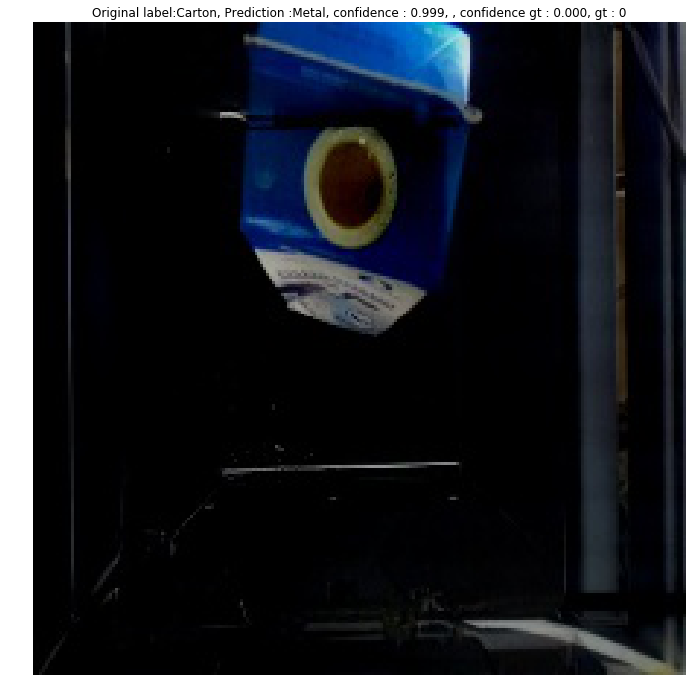

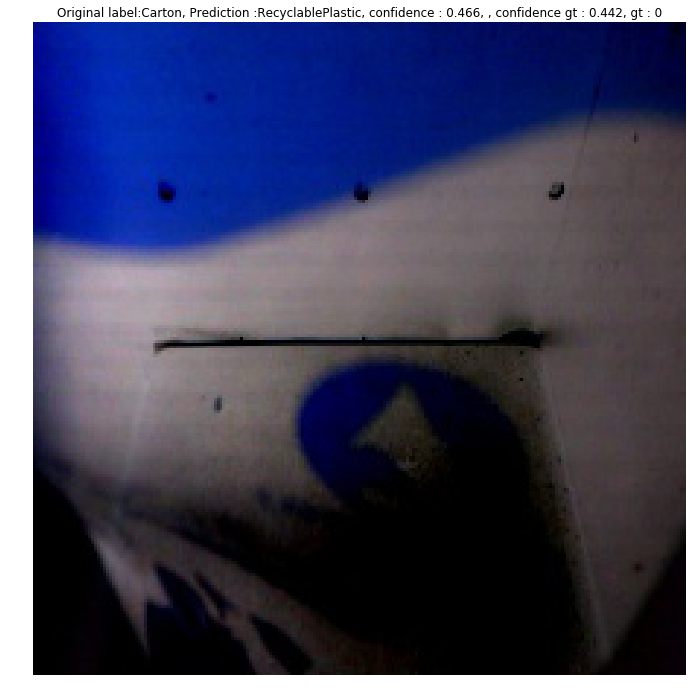

...

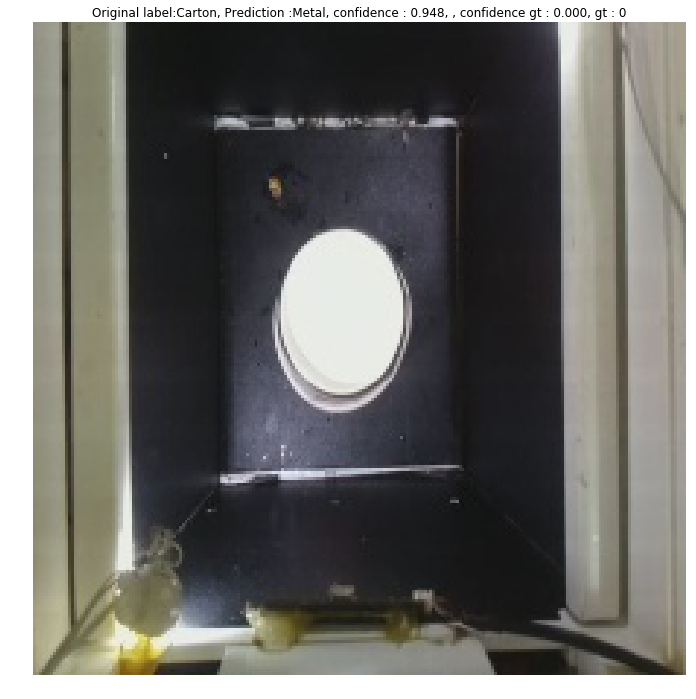

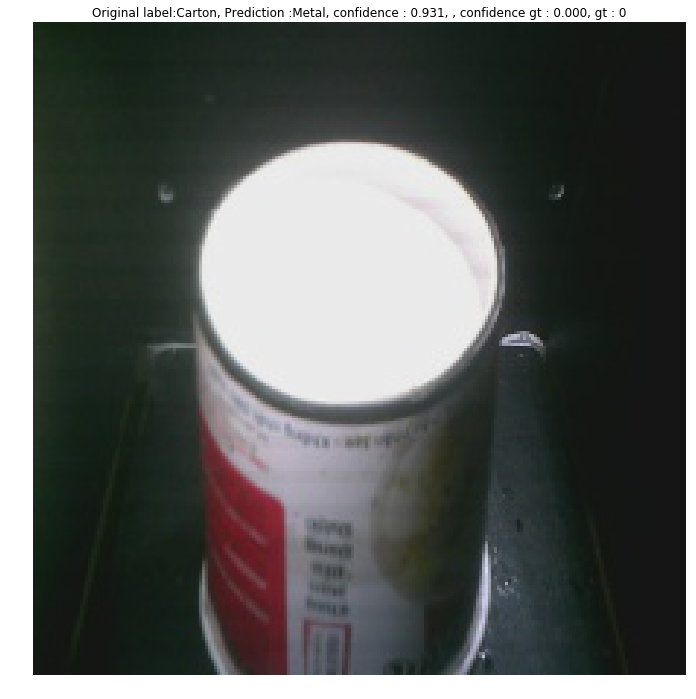

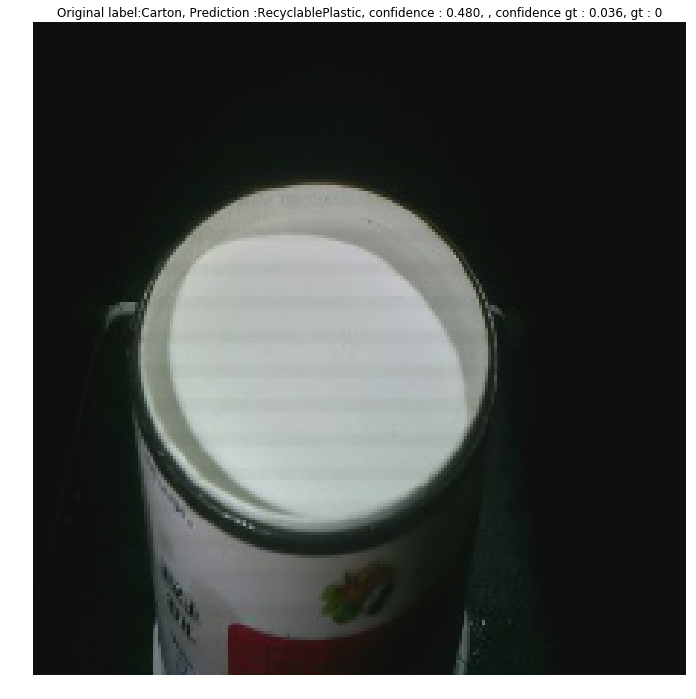

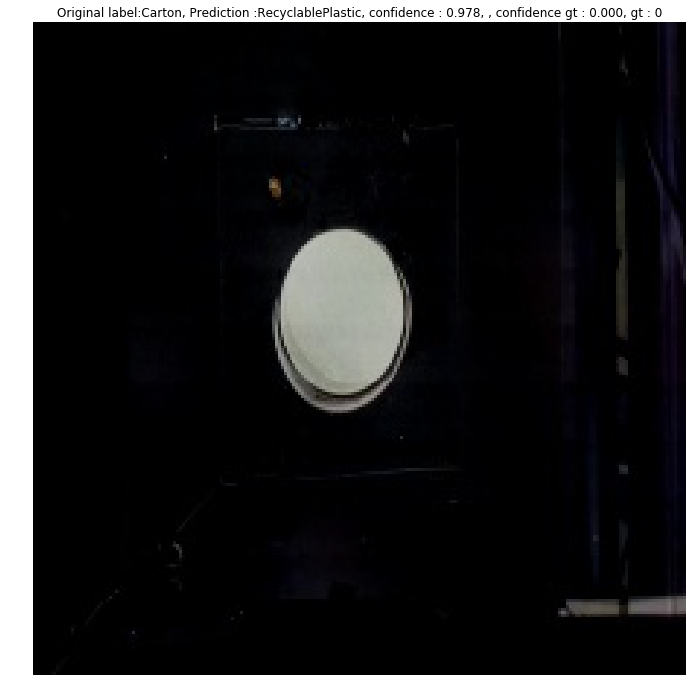

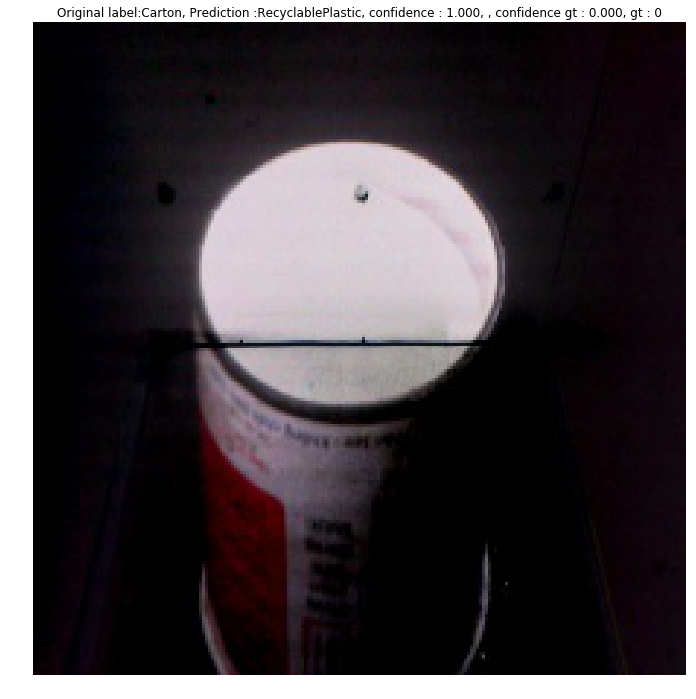

In [ ]:
# Create a generator for prediction
validation_generator = validation_datagen.flow_from_directory(
        validation_dir,
        target_size=(image_size, image_size),
        batch_size=val_batchsize,
        class_mode='categorical',
        shuffle=False)

# Get the filenames from the generator
fnames = validation_generator.filenames

# Get the ground truth from generator
ground_truth = validation_generator.classes

# Get the label to class mapping from the generator
label2index = validation_generator.class_indices
print (label2index)
# Getting the mapping from class index to class label
idx2label = dict((v,k) for k,v in label2index.items())

# Get the predictions from the model using the generator
predictions = model.predict_generator(validation_generator, steps=validation_generator.samples/validation_generator.batch_size,verbose=1)
predicted_classes = np.argmax(predictions,axis=1)

errors = np.where(predicted_classes != ground_truth)[0]
print("No of errors = {}/{}".format(len(errors),validation_generator.samples))

# Show the errors
for i in range(len(errors)):
    pred_class = np.argmax(predictions[errors[i]])
    pred_label = idx2label[pred_class]
    gt_label = ground_truth[errors[i]]
    title = 'Original label:{}, Prediction :{}, confidence : {:.3f}, , confidence gt : {:.3f}, gt : {}'.format(
        fnames[errors[i]].split('/')[0],
        pred_label,
        predictions[errors[i]][pred_class],
        predictions[errors[i]][gt_label], 
        gt_label)
    
    original = load_img('{}/{}'.format(validation_dir,fnames[errors[i]]))
    plt.figure(figsize=[12 ,12 ])
    plt.axis('off')
    plt.title(title)
    plt.imshow(original)
    plt.show()

Found 75 images belonging to 10 classes.
{'electronic': 1, 'tube': 9, 'glass': 2, 'tissue paper': 7, 'paper': 4, 'cardboard': 0, 'plastic': 5, 'tools': 8, 'metal': 3, 'softplastic': 6}
75/75 [==============================] - 1s 11ms/step
No of errors = 61/75


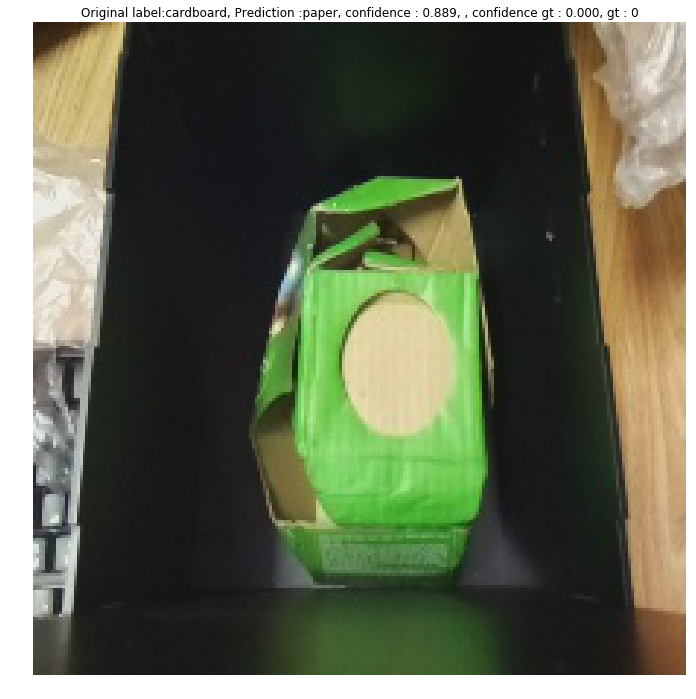

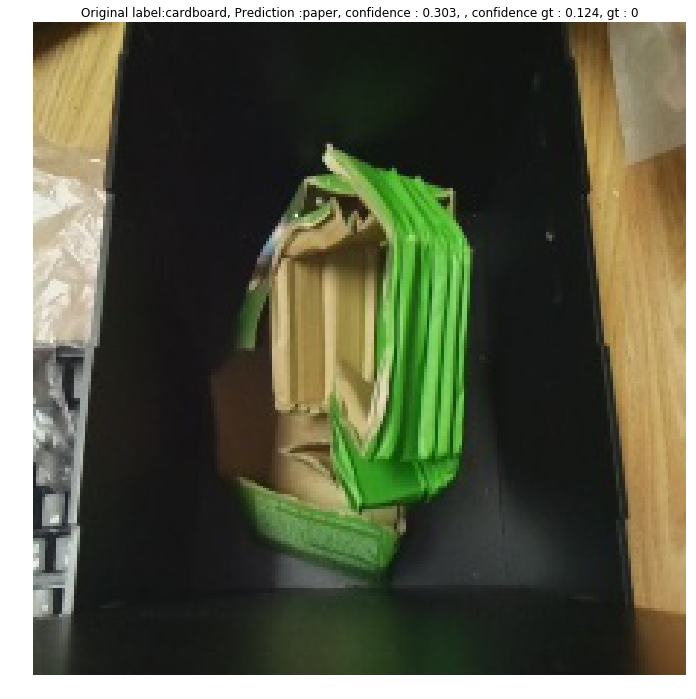

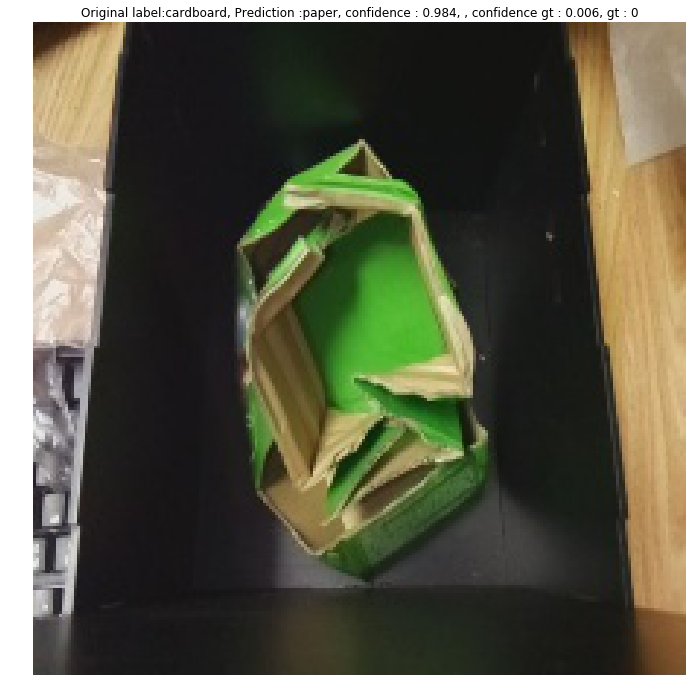

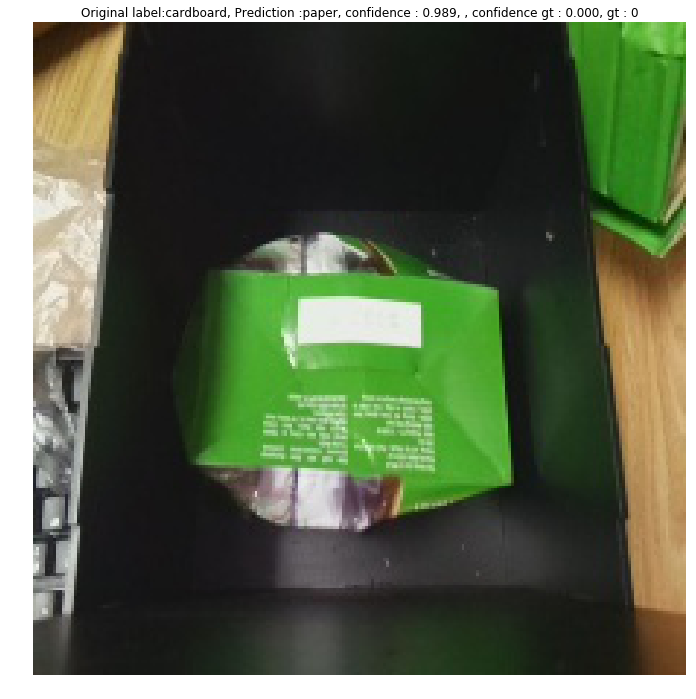

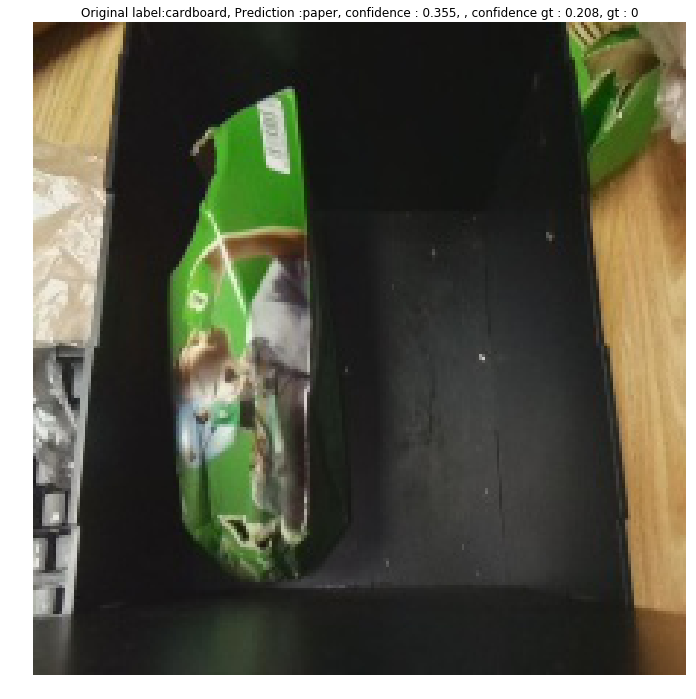

...

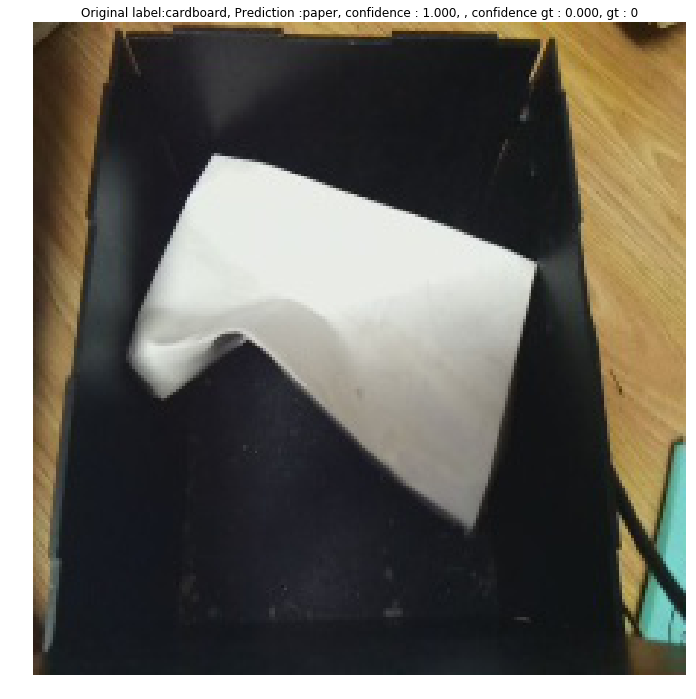

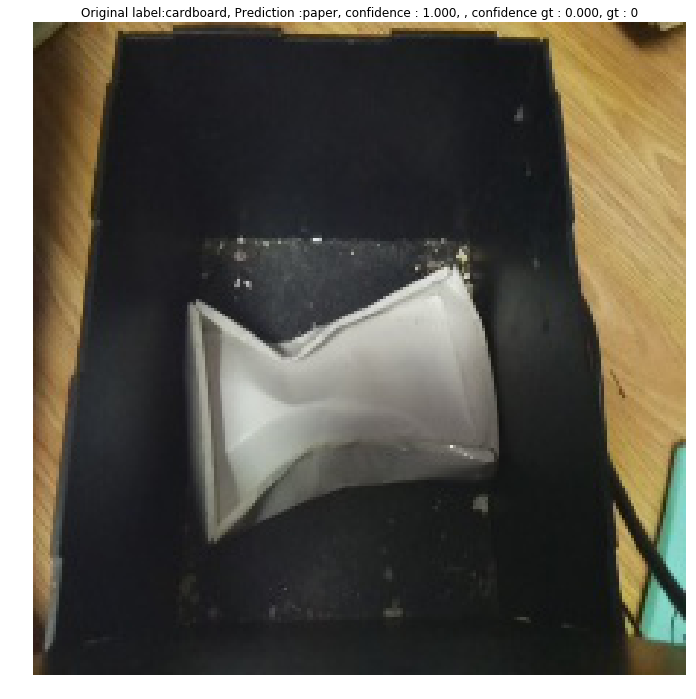

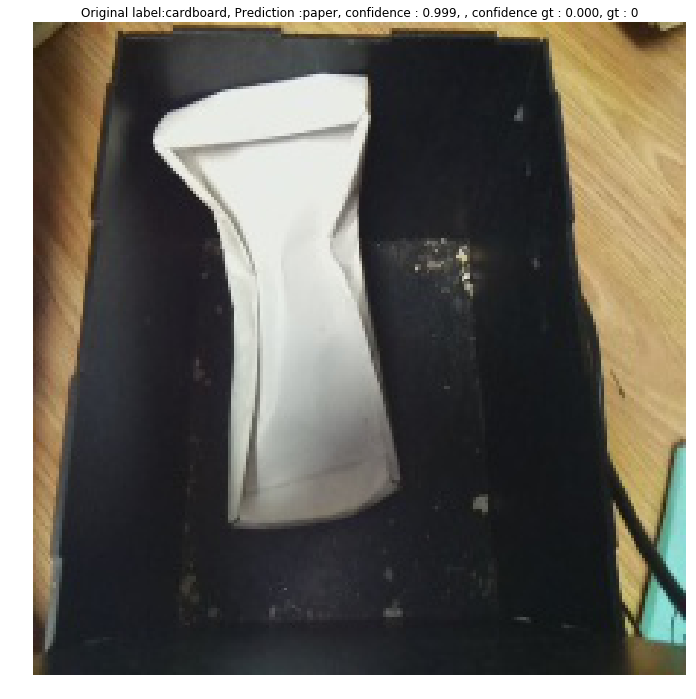

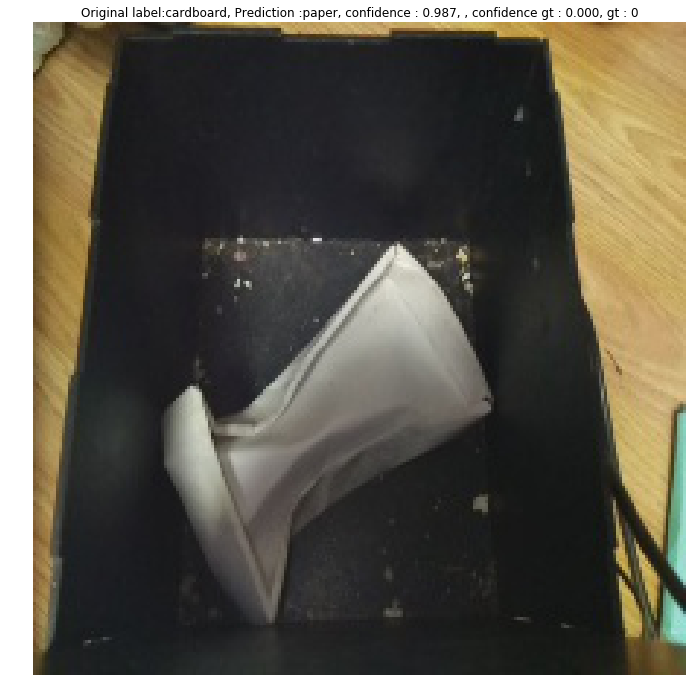

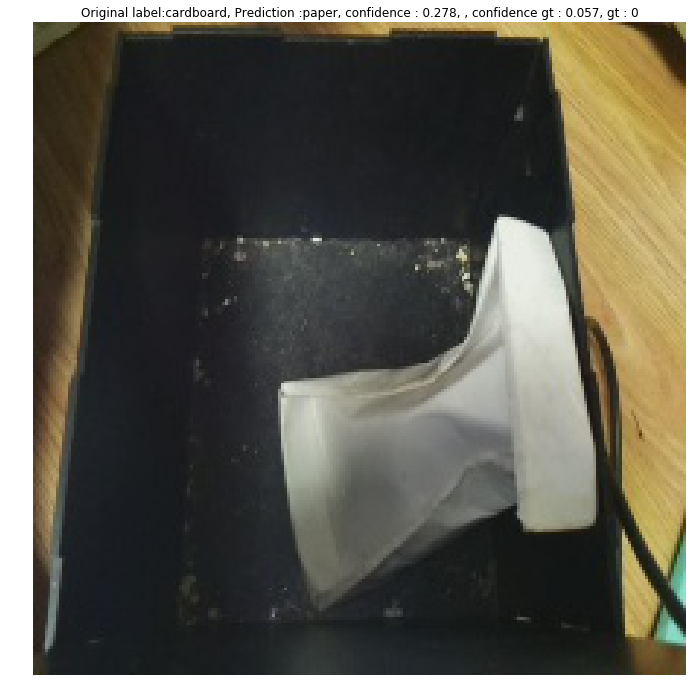

In [23]:
# FOR TEST
# Create a generator for prediction

test_datagen = ImageDataGenerator(rescale=1./255)

test_generator = test_datagen.flow_from_directory(
        test_dir,
        target_size=(image_size, image_size),
        batch_size=1,
        class_mode='categorical',
        shuffle=False)

# Get the filenames from the generator
fnames = test_generator.filenames

# Get the ground truth from generator
ground_truth = test_generator.classes

# Get the label to class mapping from the generator
label2index = test_generator.class_indices
print (label2index)
# Getting the mapping from class index to class label
idx2label = dict((v,k) for k,v in label2index.items())

# Get the predictions from the model using the generator
predictions = model.predict_generator(test_generator, steps=test_generator.samples/test_generator.batch_size,verbose=1)
predicted_classes = np.argmax(predictions,axis=1)

errors = np.where(predicted_classes != ground_truth)[0]
print("No of errors = {}/{}".format(len(errors),test_generator.samples))

# Show the errors
for i in range(len(errors)):
    pred_class = np.argmax(predictions[errors[i]])
    pred_label = idx2label[pred_class]
    gt_label = ground_truth[errors[i]]
    title = 'Original label:{}, Prediction :{}, confidence : {:.3f}, , confidence gt : {:.3f}, gt : {}'.format(
        fnames[errors[i]].split('/')[0],
        pred_label,
        predictions[errors[i]][pred_class],
        predictions[errors[i]][gt_label], 
        gt_label)
    
    original = load_img('{}/{}'.format(test_dir,fnames[errors[i]]))
    plt.figure(figsize=[12 ,12 ])
    plt.axis('off')
    plt.title(title)
    plt.imshow(original)
    plt.show()

In [45]:
model.summary()

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
vgg16 (Model)                (None, 7, 7, 512)         14714688  
_________________________________________________________________
flatten_12 (Flatten)         (None, 25088)             0         
_________________________________________________________________
dense_23 (Dense)             (None, 128)               3211392   
_________________________________________________________________
dropout_12 (Dropout)         (None, 128)               0         
_________________________________________________________________
dense_24 (Dense)             (None, 10)                1290      
Total params: 17,927,370
Trainable params: 5,572,490
Non-trainable params: 12,354,880
_________________________________________________________________


In [12]:
#all_class = ['pumpkin', 'tomato', 'watermelon']
all_class = ['ChaiBinh', 'DoDienTu', 'DungCu', 'GiayAn', 'GiayBaoTapChi', 'HopCarton', 'HuToDiaLyHop',  'LonKimLoai', 'TuiNilon', 'TuypKem' ]
image_size = 224
index2result = np.array([1, 0, 1, 1, 1, 1, 0, 0, 1, 0])


In [17]:
all_split = glob.glob(train_dir + '/*/')
print (all_split)

good_predict = 0
bad_predict = 0
model.summary()

layer_name = 'flatten_12'  #dense_6   #flatten_3
intermediate_layer_model = Model(inputs=model.input,
                                 outputs=model.get_layer(layer_name).output)

X_data = []
softmax_data = []
ground_truth_map = []
class_index = 0
for folder in all_split:
    
    class_data = []
    softmax_class_data = []
    all_img = glob.glob(folder + '*')
    
    folder_name = folder[len(train_dir):]
    print(folder_name)
    print ('N. of imgs in ' + folder_name + ' : ' + str(len(all_img)))
    
    ground_truth = -1
    for i in range(0, 10 ):
        if idx2label[i] in folder_name:
            ground_truth = i
    #ground_truth = index2result[ground_truth]  
    
    ground_truth_map.append(ground_truth)
    print (ground_truth)
    
    nofSample  = 0 
    for img_path in all_img:
        img = cv2.imread(img_path)

        img = img.reshape((1,) + img.shape)
        
        softmax = model.predict(img*(1./255))
        notSoftmax = intermediate_layer_model.predict(img*(1./255),verbose=0)
        predicted_classes = np.argmax(softmax,axis=1)

        class_data.append(notSoftmax.squeeze())
        softmax_class_data.append(softmax[0][class_index].squeeze())
        nofSample = nofSample + 1 
            
        if predicted_classes == ground_truth:
            good_predict = good_predict + 1
        else:
            bad_predict = bad_predict + 1
    print ('nofSample = ', nofSample)
    
    X_data.append(class_data)
    softmax_data.append(softmax_class_data)
    class_index = class_index + 1


X_data = [x for _,x in sorted(zip(ground_truth_map, X_data))]
softmax_data = [x for _,x in sorted(zip(ground_truth_map, softmax_data))]

print (good_predict)
print (bad_predict)

['./clean-dataset/train/tube/', './clean-dataset/train/softplastic/', './clean-dataset/train/cardboard/', './clean-dataset/train/glass/', './clean-dataset/train/metal/', './clean-dataset/train/paper/', './clean-dataset/train/tools/', './clean-dataset/train/tissue paper/', './clean-dataset/train/plastic/', './clean-dataset/train/electronic/']
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
vgg16 (Model)                (None, 7, 7, 512)         14714688  
_________________________________________________________________
flatten_12 (Flatten)         (None, 25088)             0         
_________________________________________________________________
dense_23 (Dense)             (None, 128)               3211392   
_________________________________________________________________
dropout_12 (Dropout)         (None, 128)               0         
______________________________________________________________

In [71]:
all_split = glob.glob(train_dir + '/*/')
print (all_split)

good_predict = 0
bad_predict = 0
model.summary()

layer_name = 'flatten_12'  #dense_6   #flatten_3
intermediate_layer_model = Model(inputs=model.input,
                                 outputs=model.get_layer(layer_name).output)

X_data = []
softmax_data = []
ground_truth_map = []
class_index = 0
class_data = []

for folder in all_split:
    
    softmax_class_data = []
    all_img = glob.glob(folder + '*')
    
    folder_name = folder[len(train_dir):]
    print(folder_name)
    print ('N. of imgs in ' + folder_name + ' : ' + str(len(all_img)))
    
    ground_truth = -1
    for i in range(0, 10 ):
        if idx2label[i] in folder_name:
            ground_truth = i
    
    
    print (ground_truth)
    
    nofSample  = 0 
    for img_path in all_img:
        img = cv2.imread(img_path)

        img = img.reshape((1,) + img.shape)
        
        softmax = model.predict(img*(1./255))
        notSoftmax = intermediate_layer_model.predict(img*(1./255),verbose=0)
        predicted_classes = np.argmax(softmax,axis=1)

        class_data.append(notSoftmax.squeeze())
        softmax_class_data.append(softmax[0][class_index].squeeze())
        nofSample = nofSample + 1 
        ground_truth_map.append(ground_truth)    
        if predicted_classes == ground_truth:
            good_predict = good_predict + 1
        else:
            bad_predict = bad_predict + 1
    print ('nofSample = ', nofSample)
    
    class_index = class_index + 1

['./clean-dataset/train/tube/', './clean-dataset/train/softplastic/', './clean-dataset/train/cardboard/', './clean-dataset/train/glass/', './clean-dataset/train/metal/', './clean-dataset/train/paper/', './clean-dataset/train/tools/', './clean-dataset/train/tissue paper/', './clean-dataset/train/plastic/', './clean-dataset/train/electronic/']
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
vgg16 (Model)                (None, 7, 7, 512)         14714688  
_________________________________________________________________
flatten_12 (Flatten)         (None, 25088)             0         
_________________________________________________________________
dense_23 (Dense)             (None, 128)               3211392   
_________________________________________________________________
dropout_12 (Dropout)         (None, 128)               0         
______________________________________________________________

In [63]:
print((np.array(class_data)).shape)
print((np.array(ground_truth_map)).shape)

(55, 25088)
(20066,)


In [66]:
import os
import numpy as np
from glob import glob
from pandas import DataFrame
from platform import system
from sklearn import svm
from __future__ import print_function

from time import time
import logging
import matplotlib.pyplot as plt

from sklearn.model_selection import train_test_split
from sklearn.model_selection import GridSearchCV
from sklearn.datasets import fetch_lfw_people
from sklearn.metrics import classification_report
from sklearn.metrics import confusion_matrix
from sklearn.decomposition import PCA
from sklearn.svm import SVC



In [72]:
pca = PCA(n_components=4096, svd_solver='randomized',
          whiten=True).fit(class_data)
X_train_pca = pca.transform(class_data)
print(np.array(class_data).shape)
print (X_train_pca.shape)
print (np.array(ground_truth_map).shape)
svmFitRBF = svm.SVC(kernel='rbf', cache_size=4096, probability=True).fit(X_train_pca, ground_truth_map)

(20066, 25088)
(20066, 4096)
(20066,)


In [39]:
print (svmFitRBF)

SVC(C=1.0, cache_size=4096, class_weight=None, coef0=0.0,
  decision_function_shape='ovr', degree=3, gamma='auto', kernel='rbf',
  max_iter=-1, probability=True, random_state=None, shrinking=True,
  tol=0.001, verbose=False)


In [ ]:
# K-MEAN

#print (softmax_data)
# print (X_data)
#print (np.array(np.sum(X_data[0], axis=1)))

#print (np.array(softmax_data[0]).shape)

#print (np.array(X_data[0]).shape)
z_mean = []
for i in range(0, 10):
    
    print (np.array(softmax_data[i]).shape)
    #print (np.array(X_data[i]).shape)
    data = np.array(X_data[i])
    softmax = np.array(softmax_data[i])
    
    #Z_data = [x for _,x in sorted(zip(softmax, data), reverse=True)]
    arr1inds = softmax.argsort()
    softmax_sorted = softmax[arr1inds[::-1]]
    Z_data = data[arr1inds[::-1]]
    
    z = np.array(Z_data)
    print (z.shape)
    print (int(softmax.shape[0]/5))
    #print(np.sum(Z_data, axis=1))
    
    z_mean.append(np.average(z, axis=0))
    #for j in range(0, z_mean.shape[0]-1):
    #    print (str(z_mean[j]) + ' = ' + str(z[0][j]) + ' + '+ str(z[1][j])+ ' + '+ str(z[2][j]))
    #print (z_mean)
print ('=======')
#print (z_mean[0])
#print (z_mean[1])
#print (z_mean[2])

    #print (np.sum(np.array(Z_data), axis=1))
    #print (sorted(zip(softmax, data), reverse=True))
    #print (Z_data)

In [73]:
all_split = glob.glob(validation_dir + '/*/')
print (all_split)

good_predict = 0
bad_predict = 0
good_predict_class = 0
bad_predict_class = 0 
model.summary()

layer_name = 'flatten_12'  #dense_6   #flatten_3
intermediate_layer_model = Model(inputs=model.input,
                                 outputs=model.get_layer(layer_name).output)

X_val_data = []
softmax_val_data = []
class_index = 0
for classIndex in range(0, 10):
    
    folder = ''
    
    for folderIt in all_split:
        if idx2label[classIndex] in folderIt:
            folder = folderIt
    
    class_data = []
    softmax_class_data = []
    all_img = glob.glob(folder + '*')
    print(all_img)    
    folder_name = folder[len(validation_dir):]
    print(folder_name)
    print ('N. of imgs in ' + folder_name + ' : ' + str(len(all_img)))
    
    ground_truth = -1
    for i in range(0, 10):
        if idx2label[i] in folder_name:
            ground_truth = i
    print (ground_truth)
    error_svm = 0 
    good_svm = 0 
    for img_path in all_img:
        img = cv2.imread(img_path)
        print(img_path)
        img = img.reshape((1,) + img.shape)
        
        softmax = model.predict(img*(1./255))
        notSoftmax = intermediate_layer_model.predict(img*(1./255),verbose=0)
        class_data.append(notSoftmax.squeeze())
        print((notSoftmax.squeeze()).reshape(1, -1).shape)
        test_img = pca.transform((notSoftmax.squeeze()).reshape(1, -1))

        predicted_svm = svmFitRBF.predict(test_img)
        
        predicted_classes = np.argmax(softmax,axis=1)
        
        #
        #min_dist = 99999
        #predicted_nn = -1
        #print ('===============')
        #for i in range(0, 10 ):
        #    dist = np.linalg.norm(notSoftmax[0]- z_mean[i])
        #    print (dist, ' - ', i )
        #    #print (i)
        #    #print (z_mean[i])
        #    #print (notSoftmax[0])
        #    if dist < min_dist:
        #       min_dist = dist
        #       predicted_nn = i
        print ('')
        print ('predicted_svm = ', predicted_svm)
        print ('ground_truth = ', ground_truth)
        print ('predicted_classes = ', predicted_classes)
        softmax_class_data.append(softmax[0][class_index].squeeze())
        
        
        if predicted_svm == ground_truth:
            good_predict = good_predict + 1
            good_svm = good_svm + 1 
        else:
            bad_predict = bad_predict + 1
            error_svm = error_svm + 1 
        print ('error_svm = ', error_svm) 
        print ('good_svm = ', good_svm)
        if predicted_classes == ground_truth:
            good_predict_class = good_predict_class + 1
        else:
            bad_predict_class = bad_predict_class + 1
    
    class_index = class_index + 1
    total = good_svm + error_svm
    if total != 0:
        print ('accuracy class: ', good_svm/(1.0*total))
print ('accuracy = ', good_predict_class/(1.0*(good_predict_class + bad_predict_class)))
print ('accuracy svm = ', good_predict/(1.0*(good_predict + bad_predict)))


['./clean-dataset/validation/tube/', './clean-dataset/validation/softplastic/', './clean-dataset/validation/cardboard/', './clean-dataset/validation/glass/', './clean-dataset/validation/metal/', './clean-dataset/validation/paper/', './clean-dataset/validation/tools/', './clean-dataset/validation/tissue paper/', './clean-dataset/validation/plastic/', './clean-dataset/validation/electronic/']
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
vgg16 (Model)                (None, 7, 7, 512)         14714688  
_________________________________________________________________
flatten_12 (Flatten)         (None, 25088)             0         
_________________________________________________________________
dense_23 (Dense)             (None, 128)               3211392   
_________________________________________________________________
dropout_12 (Dropout)         (None, 128)               0         
____________


predicted_svm =  [5]
ground_truth =  0
predicted_classes =  [6]
error_svm =  13
good_svm =  2
./clean-dataset/validation/cardboard/20171222064757726.jpg
(1, 25088)

predicted_svm =  [4]
ground_truth =  0
predicted_classes =  [4]
error_svm =  14
good_svm =  2
./clean-dataset/validation/cardboard/20171229091512696.jpg
(1, 25088)

predicted_svm =  [4]
ground_truth =  0
predicted_classes =  [4]
error_svm =  15
good_svm =  2
./clean-dataset/validation/cardboard/444221.jpg
(1, 25088)

predicted_svm =  [0]
ground_truth =  0
predicted_classes =  [0]
error_svm =  15
good_svm =  3
./clean-dataset/validation/cardboard/20171229091506468.jpg
(1, 25088)

predicted_svm =  [4]
ground_truth =  0
predicted_classes =  [4]
error_svm =  16
good_svm =  3
./clean-dataset/validation/cardboard/20180103043729555.jpg
(1, 25088)

predicted_svm =  [4]
ground_truth =  0
predicted_classes =  [4]
error_svm =  17
good_svm =  3
./clean-dataset/validation/cardboard/20180103043724434.jpg
(1, 25088)

predicted_svm =  [4]


predicted_svm =  [4]
ground_truth =  0
predicted_classes =  [4]
error_svm =  53
good_svm =  12
./clean-dataset/validation/cardboard/20180103043701297.jpg
(1, 25088)

predicted_svm =  [4]
ground_truth =  0
predicted_classes =  [5]
error_svm =  54
good_svm =  12
./clean-dataset/validation/cardboard/20171227090852983.jpg
(1, 25088)

predicted_svm =  [6]
ground_truth =  0
predicted_classes =  [6]
error_svm =  55
good_svm =  12
./clean-dataset/validation/cardboard/444226.jpg
(1, 25088)

predicted_svm =  [0]
ground_truth =  0
predicted_classes =  [0]
error_svm =  55
good_svm =  13
./clean-dataset/validation/cardboard/20171222080857847.jpg
(1, 25088)

predicted_svm =  [4]
ground_truth =  0
predicted_classes =  [0]
error_svm =  56
good_svm =  13
./clean-dataset/validation/cardboard/20171223012244335.jpg
(1, 25088)

predicted_svm =  [0]
ground_truth =  0
predicted_classes =  [4]
error_svm =  56
good_svm =  14
./clean-dataset/validation/cardboard/444229.jpg
(1, 25088)

predicted_svm =  [1]
grou


predicted_svm =  [5]
ground_truth =  1
predicted_classes =  [6]
error_svm =  22
good_svm =  4
./clean-dataset/validation/electronic/20180102091117190.jpg
(1, 25088)

predicted_svm =  [4]
ground_truth =  1
predicted_classes =  [4]
error_svm =  23
good_svm =  4
./clean-dataset/validation/electronic/20171222101500022.jpg
(1, 25088)

predicted_svm =  [1]
ground_truth =  1
predicted_classes =  [6]
error_svm =  23
good_svm =  5
./clean-dataset/validation/electronic/20180102091119806.jpg
(1, 25088)

predicted_svm =  [4]
ground_truth =  1
predicted_classes =  [6]
error_svm =  24
good_svm =  5
./clean-dataset/validation/electronic/20171222101156286.jpg
(1, 25088)

predicted_svm =  [5]
ground_truth =  1
predicted_classes =  [6]
error_svm =  25
good_svm =  5
./clean-dataset/validation/electronic/20180102091132479.jpg
(1, 25088)

predicted_svm =  [6]
ground_truth =  1
predicted_classes =  [8]
error_svm =  26
good_svm =  5
./clean-dataset/validation/electronic/20171222101456704.jpg
(1, 25088)

pre


predicted_svm =  [5]
ground_truth =  3
predicted_classes =  [4]
error_svm =  6
good_svm =  6
./clean-dataset/validation/metal/20171227074522780.jpg
(1, 25088)

predicted_svm =  [3]
ground_truth =  3
predicted_classes =  [3]
error_svm =  6
good_svm =  7
./clean-dataset/validation/metal/20171227074544516.jpg
(1, 25088)

predicted_svm =  [3]
ground_truth =  3
predicted_classes =  [3]
error_svm =  6
good_svm =  8
./clean-dataset/validation/metal/20171227080707740.jpg
(1, 25088)

predicted_svm =  [5]
ground_truth =  3
predicted_classes =  [3]
error_svm =  7
good_svm =  8
./clean-dataset/validation/metal/20171227074538119.jpg
(1, 25088)

predicted_svm =  [5]
ground_truth =  3
predicted_classes =  [5]
error_svm =  8
good_svm =  8
./clean-dataset/validation/metal/20171227080623761.jpg
(1, 25088)

predicted_svm =  [3]
ground_truth =  3
predicted_classes =  [3]
error_svm =  8
good_svm =  9
./clean-dataset/validation/metal/20171222063818581.jpg
(1, 25088)

predicted_svm =  [5]
ground_truth =  3



predicted_svm =  [3]
ground_truth =  3
predicted_classes =  [3]
error_svm =  36
good_svm =  27
./clean-dataset/validation/metal/20171222063816085.jpg
(1, 25088)

predicted_svm =  [5]
ground_truth =  3
predicted_classes =  [5]
error_svm =  37
good_svm =  27
./clean-dataset/validation/metal/20171222063821206.jpg
(1, 25088)

predicted_svm =  [4]
ground_truth =  3
predicted_classes =  [4]
error_svm =  38
good_svm =  27
./clean-dataset/validation/metal/20171227092247139.jpg
(1, 25088)

predicted_svm =  [5]
ground_truth =  3
predicted_classes =  [3]
error_svm =  39
good_svm =  27
./clean-dataset/validation/metal/20171227092253348.jpg
(1, 25088)

predicted_svm =  [5]
ground_truth =  3
predicted_classes =  [3]
error_svm =  40
good_svm =  27
./clean-dataset/validation/metal/20171222063808024.jpg
(1, 25088)

predicted_svm =  [5]
ground_truth =  3
predicted_classes =  [3]
error_svm =  41
good_svm =  27
./clean-dataset/validation/metal/20171227072346712.jpg
(1, 25088)

predicted_svm =  [3]
ground


predicted_svm =  [9]
ground_truth =  7
predicted_classes =  [7]
error_svm =  25
good_svm =  0
./clean-dataset/validation/tissue paper/20171222063455762.jpg
(1, 25088)

predicted_svm =  [5]
ground_truth =  7
predicted_classes =  [4]
error_svm =  26
good_svm =  0
./clean-dataset/validation/tissue paper/20180102082937988.jpg
(1, 25088)

predicted_svm =  [9]
ground_truth =  7
predicted_classes =  [6]
error_svm =  27
good_svm =  0
accuracy class:  0.0
['./clean-dataset/validation/plastic/20171227072940533.jpg', './clean-dataset/validation/plastic/20171222174939911.jpg', './clean-dataset/validation/plastic/20171227072949586.jpg', './clean-dataset/validation/plastic/20180103040456782.jpg', './clean-dataset/validation/plastic/20171222112846079.jpg', './clean-dataset/validation/plastic/20180103040357672.jpg', './clean-dataset/validation/plastic/20171222174913003.jpg', './clean-dataset/validation/plastic/20171222141018985.jpg', './clean-dataset/validation/plastic/20171222174925272.jpg', './clea


predicted_svm =  [5]
ground_truth =  5
predicted_classes =  [5]
error_svm =  0
good_svm =  1
./clean-dataset/validation/plastic/20171222174939911.jpg
(1, 25088)

predicted_svm =  [6]
ground_truth =  5
predicted_classes =  [4]
error_svm =  1
good_svm =  1
./clean-dataset/validation/plastic/20171227072949586.jpg
(1, 25088)

predicted_svm =  [5]
ground_truth =  5
predicted_classes =  [5]
error_svm =  1
good_svm =  2
./clean-dataset/validation/plastic/20180103040456782.jpg
(1, 25088)

predicted_svm =  [5]
ground_truth =  5
predicted_classes =  [6]
error_svm =  1
good_svm =  3
./clean-dataset/validation/plastic/20171222112846079.jpg
(1, 25088)

predicted_svm =  [1]
ground_truth =  5
predicted_classes =  [5]
error_svm =  2
good_svm =  3
./clean-dataset/validation/plastic/20180103040357672.jpg
(1, 25088)

predicted_svm =  [0]
ground_truth =  5
predicted_classes =  [5]
error_svm =  3
good_svm =  3
./clean-dataset/validation/plastic/20171222174913003.jpg
(1, 25088)

predicted_svm =  [5]
ground


predicted_svm =  [5]
ground_truth =  5
predicted_classes =  [5]
error_svm =  16
good_svm =  36
./clean-dataset/validation/plastic/20171227092012049.jpg
(1, 25088)

predicted_svm =  [5]
ground_truth =  5
predicted_classes =  [3]
error_svm =  16
good_svm =  37
./clean-dataset/validation/plastic/20171222061615448.jpg
(1, 25088)

predicted_svm =  [5]
ground_truth =  5
predicted_classes =  [5]
error_svm =  16
good_svm =  38
./clean-dataset/validation/plastic/20171222112926271.jpg
(1, 25088)

predicted_svm =  [5]
ground_truth =  5
predicted_classes =  [5]
error_svm =  16
good_svm =  39
./clean-dataset/validation/plastic/20171222174814808.jpg
(1, 25088)

predicted_svm =  [5]
ground_truth =  5
predicted_classes =  [4]
error_svm =  16
good_svm =  40
./clean-dataset/validation/plastic/20171227092003058.jpg
(1, 25088)

predicted_svm =  [5]
ground_truth =  5
predicted_classes =  [5]
error_svm =  16
good_svm =  41
./clean-dataset/validation/plastic/20180103040503991.jpg
(1, 25088)

predicted_svm =


predicted_svm =  [4]
ground_truth =  5
predicted_classes =  [4]
error_svm =  21
good_svm =  81
./clean-dataset/validation/plastic/20171227091917894.jpg
(1, 25088)

predicted_svm =  [3]
ground_truth =  5
predicted_classes =  [3]
error_svm =  22
good_svm =  81
./clean-dataset/validation/plastic/20180103040404025.jpg
(1, 25088)

predicted_svm =  [4]
ground_truth =  5
predicted_classes =  [5]
error_svm =  23
good_svm =  81
./clean-dataset/validation/plastic/20171227073013317.jpg
(1, 25088)

predicted_svm =  [5]
ground_truth =  5
predicted_classes =  [5]
error_svm =  23
good_svm =  82
./clean-dataset/validation/plastic/20180103040448774.jpg
(1, 25088)

predicted_svm =  [4]
ground_truth =  5
predicted_classes =  [5]
error_svm =  24
good_svm =  82
./clean-dataset/validation/plastic/20171227090529409.jpg
(1, 25088)

predicted_svm =  [5]
ground_truth =  5
predicted_classes =  [5]
error_svm =  24
good_svm =  83
./clean-dataset/validation/plastic/20171227091958111.jpg
(1, 25088)

predicted_svm =


predicted_svm =  [5]
ground_truth =  5
predicted_classes =  [5]
error_svm =  33
good_svm =  119
./clean-dataset/validation/plastic/20171227073004209.jpg
(1, 25088)

predicted_svm =  [5]
ground_truth =  5
predicted_classes =  [5]
error_svm =  33
good_svm =  120
./clean-dataset/validation/plastic/20171222100154059.jpg
(1, 25088)

predicted_svm =  [1]
ground_truth =  5
predicted_classes =  [3]
error_svm =  34
good_svm =  120
./clean-dataset/validation/plastic/20171227072954329.jpg
(1, 25088)

predicted_svm =  [5]
ground_truth =  5
predicted_classes =  [5]
error_svm =  34
good_svm =  121
./clean-dataset/validation/plastic/20171227080606981.jpg
(1, 25088)

predicted_svm =  [5]
ground_truth =  5
predicted_classes =  [5]
error_svm =  34
good_svm =  122
./clean-dataset/validation/plastic/20171222174819820.jpg
(1, 25088)

predicted_svm =  [5]
ground_truth =  5
predicted_classes =  [4]
error_svm =  34
good_svm =  123
./clean-dataset/validation/plastic/20171222140934999.jpg
(1, 25088)

predicted


predicted_svm =  [5]
ground_truth =  5
predicted_classes =  [5]
error_svm =  46
good_svm =  156
./clean-dataset/validation/plastic/20171222073528036.jpg
(1, 25088)

predicted_svm =  [4]
ground_truth =  5
predicted_classes =  [4]
error_svm =  47
good_svm =  156
./clean-dataset/validation/plastic/20180103040417088.jpg
(1, 25088)

predicted_svm =  [5]
ground_truth =  5
predicted_classes =  [5]
error_svm =  47
good_svm =  157
./clean-dataset/validation/plastic/20171222073540075.jpg
(1, 25088)

predicted_svm =  [5]
ground_truth =  5
predicted_classes =  [5]
error_svm =  47
good_svm =  158
./clean-dataset/validation/plastic/20171227072759385.jpg
(1, 25088)

predicted_svm =  [5]
ground_truth =  5
predicted_classes =  [5]
error_svm =  47
good_svm =  159
./clean-dataset/validation/plastic/20180103040451922.jpg
(1, 25088)

predicted_svm =  [4]
ground_truth =  5
predicted_classes =  [6]
error_svm =  48
good_svm =  159
./clean-dataset/validation/plastic/20171222174841117.jpg
(1, 25088)

predicted


predicted_svm =  [9]
ground_truth =  5
predicted_classes =  [5]
error_svm =  57
good_svm =  195
./clean-dataset/validation/plastic/20171222112914899.jpg
(1, 25088)

predicted_svm =  [5]
ground_truth =  5
predicted_classes =  [3]
error_svm =  57
good_svm =  196
./clean-dataset/validation/plastic/20171222112939708.jpg
(1, 25088)

predicted_svm =  [5]
ground_truth =  5
predicted_classes =  [5]
error_svm =  57
good_svm =  197
./clean-dataset/validation/plastic/20171227092014118.jpg
(1, 25088)

predicted_svm =  [5]
ground_truth =  5
predicted_classes =  [5]
error_svm =  57
good_svm =  198
./clean-dataset/validation/plastic/20180103040142297.jpg
(1, 25088)

predicted_svm =  [5]
ground_truth =  5
predicted_classes =  [5]
error_svm =  57
good_svm =  199
./clean-dataset/validation/plastic/20171222062615702.jpg
(1, 25088)

predicted_svm =  [5]
ground_truth =  5
predicted_classes =  [5]
error_svm =  57
good_svm =  200
./clean-dataset/validation/plastic/20171227091950260.jpg
(1, 25088)

predicted


predicted_svm =  [6]
ground_truth =  6
predicted_classes =  [6]
error_svm =  0
good_svm =  1
./clean-dataset/validation/softplastic/20180103032916851.jpg
(1, 25088)

predicted_svm =  [4]
ground_truth =  6
predicted_classes =  [6]
error_svm =  1
good_svm =  1
./clean-dataset/validation/softplastic/20180102081952411.jpg
(1, 25088)

predicted_svm =  [6]
ground_truth =  6
predicted_classes =  [6]
error_svm =  1
good_svm =  2
./clean-dataset/validation/softplastic/20171229071610250.jpg
(1, 25088)

predicted_svm =  [6]
ground_truth =  6
predicted_classes =  [6]
error_svm =  1
good_svm =  3
./clean-dataset/validation/softplastic/20171222123754689.jpg
(1, 25088)

predicted_svm =  [6]
ground_truth =  6
predicted_classes =  [6]
error_svm =  1
good_svm =  4
./clean-dataset/validation/softplastic/20171229084039969.jpg
(1, 25088)

predicted_svm =  [6]
ground_truth =  6
predicted_classes =  [6]
error_svm =  1
good_svm =  5
./clean-dataset/validation/softplastic/20171229071613892.jpg
(1, 25088)

pre


predicted_svm =  [6]
ground_truth =  6
predicted_classes =  [6]
error_svm =  8
good_svm =  43
./clean-dataset/validation/softplastic/20180102082016447.jpg
(1, 25088)

predicted_svm =  [6]
ground_truth =  6
predicted_classes =  [6]
error_svm =  8
good_svm =  44
./clean-dataset/validation/softplastic/20171229071049041.jpg
(1, 25088)

predicted_svm =  [6]
ground_truth =  6
predicted_classes =  [6]
error_svm =  8
good_svm =  45
./clean-dataset/validation/softplastic/20171229083411473.jpg
(1, 25088)

predicted_svm =  [6]
ground_truth =  6
predicted_classes =  [6]
error_svm =  8
good_svm =  46
./clean-dataset/validation/softplastic/20180103032944567.jpg
(1, 25088)

predicted_svm =  [4]
ground_truth =  6
predicted_classes =  [6]
error_svm =  9
good_svm =  46
./clean-dataset/validation/softplastic/20171229083802513.jpg
(1, 25088)

predicted_svm =  [6]
ground_truth =  6
predicted_classes =  [6]
error_svm =  9
good_svm =  47
./clean-dataset/validation/softplastic/20171229074007034.jpg
(1, 25088


predicted_svm =  [6]
ground_truth =  6
predicted_classes =  [6]
error_svm =  16
good_svm =  84
./clean-dataset/validation/softplastic/20171229083414067.jpg
(1, 25088)

predicted_svm =  [6]
ground_truth =  6
predicted_classes =  [6]
error_svm =  16
good_svm =  85
./clean-dataset/validation/softplastic/20171222094318978.jpg
(1, 25088)

predicted_svm =  [4]
ground_truth =  6
predicted_classes =  [3]
error_svm =  17
good_svm =  85
./clean-dataset/validation/softplastic/20180103032928934.jpg
(1, 25088)

predicted_svm =  [4]
ground_truth =  6
predicted_classes =  [4]
error_svm =  18
good_svm =  85
./clean-dataset/validation/softplastic/20171222094332173.jpg
(1, 25088)

predicted_svm =  [5]
ground_truth =  6
predicted_classes =  [3]
error_svm =  19
good_svm =  85
./clean-dataset/validation/softplastic/20171229071030407.jpg
(1, 25088)

predicted_svm =  [6]
ground_truth =  6
predicted_classes =  [6]
error_svm =  19
good_svm =  86
./clean-dataset/validation/softplastic/20171229071019612.jpg
(1,


predicted_svm =  [6]
ground_truth =  6
predicted_classes =  [6]
error_svm =  25
good_svm =  124
./clean-dataset/validation/softplastic/20171222123733099.jpg
(1, 25088)

predicted_svm =  [6]
ground_truth =  6
predicted_classes =  [6]
error_svm =  25
good_svm =  125
./clean-dataset/validation/softplastic/20180102082008047.jpg
(1, 25088)

predicted_svm =  [6]
ground_truth =  6
predicted_classes =  [6]
error_svm =  25
good_svm =  126
./clean-dataset/validation/softplastic/20171229072754750.jpg
(1, 25088)

predicted_svm =  [6]
ground_truth =  6
predicted_classes =  [6]
error_svm =  25
good_svm =  127
./clean-dataset/validation/softplastic/20171229083421214.jpg
(1, 25088)

predicted_svm =  [6]
ground_truth =  6
predicted_classes =  [6]
error_svm =  25
good_svm =  128
./clean-dataset/validation/softplastic/20171222123751068.jpg
(1, 25088)

predicted_svm =  [6]
ground_truth =  6
predicted_classes =  [6]
error_svm =  25
good_svm =  129
./clean-dataset/validation/softplastic/20171229084044222.j


predicted_svm =  [6]
ground_truth =  6
predicted_classes =  [6]
error_svm =  32
good_svm =  166
./clean-dataset/validation/softplastic/20180102082005117.jpg
(1, 25088)

predicted_svm =  [6]
ground_truth =  6
predicted_classes =  [6]
error_svm =  32
good_svm =  167
./clean-dataset/validation/softplastic/20171229071602973.jpg
(1, 25088)

predicted_svm =  [6]
ground_truth =  6
predicted_classes =  [6]
error_svm =  32
good_svm =  168
./clean-dataset/validation/softplastic/20171229084031456.jpg
(1, 25088)

predicted_svm =  [6]
ground_truth =  6
predicted_classes =  [6]
error_svm =  32
good_svm =  169
./clean-dataset/validation/softplastic/20180103032955927.jpg
(1, 25088)

predicted_svm =  [4]
ground_truth =  6
predicted_classes =  [4]
error_svm =  33
good_svm =  169
./clean-dataset/validation/softplastic/20171222094304613.jpg
(1, 25088)

predicted_svm =  [5]
ground_truth =  6
predicted_classes =  [5]
error_svm =  34
good_svm =  169
./clean-dataset/validation/softplastic/20171229071036329.j


predicted_svm =  [9]
ground_truth =  7
predicted_classes =  [4]
error_svm =  19
good_svm =  0
./clean-dataset/validation/tissue paper/20171222063412581.jpg
(1, 25088)

predicted_svm =  [4]
ground_truth =  7
predicted_classes =  [4]
error_svm =  20
good_svm =  0
./clean-dataset/validation/tissue paper/20171222063417372.jpg
(1, 25088)

predicted_svm =  [4]
ground_truth =  7
predicted_classes =  [4]
error_svm =  21
good_svm =  0
./clean-dataset/validation/tissue paper/20171222203920809.jpg
(1, 25088)

predicted_svm =  [4]
ground_truth =  7
predicted_classes =  [4]
error_svm =  22
good_svm =  0
./clean-dataset/validation/tissue paper/20180102082925323.jpg
(1, 25088)

predicted_svm =  [9]
ground_truth =  7
predicted_classes =  [4]
error_svm =  23
good_svm =  0
./clean-dataset/validation/tissue paper/20180102082928982.jpg
(1, 25088)

predicted_svm =  [9]
ground_truth =  7
predicted_classes =  [4]
error_svm =  24
good_svm =  0
./clean-dataset/validation/tissue paper/20180102082842722.jpg
(1,


predicted_svm =  [8]
ground_truth =  8
predicted_classes =  [8]
error_svm =  0
good_svm =  1
./clean-dataset/validation/tools/20171222130502360.jpg
(1, 25088)

predicted_svm =  [8]
ground_truth =  8
predicted_classes =  [8]
error_svm =  0
good_svm =  2
./clean-dataset/validation/tools/20171222130505195.jpg
(1, 25088)

predicted_svm =  [8]
ground_truth =  8
predicted_classes =  [8]
error_svm =  0
good_svm =  3
./clean-dataset/validation/tools/20171222171300461.jpg
(1, 25088)

predicted_svm =  [8]
ground_truth =  8
predicted_classes =  [8]
error_svm =  0
good_svm =  4
./clean-dataset/validation/tools/20171222171617388.jpg
(1, 25088)

predicted_svm =  [8]
ground_truth =  8
predicted_classes =  [8]
error_svm =  0
good_svm =  5
./clean-dataset/validation/tools/20171222130424185.jpg
(1, 25088)

predicted_svm =  [8]
ground_truth =  8
predicted_classes =  [8]
error_svm =  0
good_svm =  6
./clean-dataset/validation/tools/20171222171528527.jpg
(1, 25088)

predicted_svm =  [8]
ground_truth =  8



predicted_svm =  [8]
ground_truth =  8
predicted_classes =  [8]
error_svm =  6
good_svm =  46
./clean-dataset/validation/tools/20171222130441012.jpg
(1, 25088)

predicted_svm =  [8]
ground_truth =  8
predicted_classes =  [8]
error_svm =  6
good_svm =  47
./clean-dataset/validation/tools/20171229092000466.jpg
(1, 25088)

predicted_svm =  [4]
ground_truth =  8
predicted_classes =  [8]
error_svm =  7
good_svm =  47
./clean-dataset/validation/tools/20171222130443419.jpg
(1, 25088)

predicted_svm =  [8]
ground_truth =  8
predicted_classes =  [8]
error_svm =  7
good_svm =  48
./clean-dataset/validation/tools/20171222130513258.jpg
(1, 25088)

predicted_svm =  [8]
ground_truth =  8
predicted_classes =  [8]
error_svm =  7
good_svm =  49
./clean-dataset/validation/tools/20171222142117412.jpg
(1, 25088)

predicted_svm =  [8]
ground_truth =  8
predicted_classes =  [8]
error_svm =  7
good_svm =  50
./clean-dataset/validation/tools/20171229091950938.jpg
(1, 25088)

predicted_svm =  [4]
ground_truth


predicted_svm =  [8]
ground_truth =  8
predicted_classes =  [6]
error_svm =  11
good_svm =  92
./clean-dataset/validation/tools/20171222141926932.jpg
(1, 25088)

predicted_svm =  [8]
ground_truth =  8
predicted_classes =  [8]
error_svm =  11
good_svm =  93
./clean-dataset/validation/tools/20171222171253696.jpg
(1, 25088)

predicted_svm =  [8]
ground_truth =  8
predicted_classes =  [8]
error_svm =  11
good_svm =  94
./clean-dataset/validation/tools/20171222130510851.jpg
(1, 25088)

predicted_svm =  [8]
ground_truth =  8
predicted_classes =  [8]
error_svm =  11
good_svm =  95
./clean-dataset/validation/tools/20171222141836913.jpg
(1, 25088)

predicted_svm =  [8]
ground_truth =  8
predicted_classes =  [8]
error_svm =  11
good_svm =  96
./clean-dataset/validation/tools/20171222141833141.jpg
(1, 25088)

predicted_svm =  [8]
ground_truth =  8
predicted_classes =  [8]
error_svm =  11
good_svm =  97
./clean-dataset/validation/tools/20171222142052311.jpg
(1, 25088)

predicted_svm =  [8]
ground


predicted_svm =  [9]
ground_truth =  9
predicted_classes =  [9]
error_svm =  0
good_svm =  1
./clean-dataset/validation/tube/20171222063229712.jpg
(1, 25088)

predicted_svm =  [4]
ground_truth =  9
predicted_classes =  [4]
error_svm =  1
good_svm =  1
./clean-dataset/validation/tube/20180103074601590.jpg
(1, 25088)

predicted_svm =  [9]
ground_truth =  9
predicted_classes =  [9]
error_svm =  1
good_svm =  2
./clean-dataset/validation/tube/20180102083703764.jpg
(1, 25088)

predicted_svm =  [9]
ground_truth =  9
predicted_classes =  [9]
error_svm =  1
good_svm =  3
./clean-dataset/validation/tube/20171222063218859.jpg
(1, 25088)

predicted_svm =  [4]
ground_truth =  9
predicted_classes =  [9]
error_svm =  2
good_svm =  3
./clean-dataset/validation/tube/20180102083635475.jpg
(1, 25088)

predicted_svm =  [4]
ground_truth =  9
predicted_classes =  [6]
error_svm =  3
good_svm =  3
./clean-dataset/validation/tube/20180103074621171.jpg
(1, 25088)

predicted_svm =  [9]
ground_truth =  9
predic


predicted_svm =  [4]
ground_truth =  9
predicted_classes =  [4]
error_svm =  29
good_svm =  24
./clean-dataset/validation/tube/20180103074619636.jpg
(1, 25088)

predicted_svm =  [4]
ground_truth =  9
predicted_classes =  [4]
error_svm =  30
good_svm =  24
./clean-dataset/validation/tube/20180103074555655.jpg
(1, 25088)

predicted_svm =  [9]
ground_truth =  9
predicted_classes =  [9]
error_svm =  30
good_svm =  25
accuracy class:  0.45454545454545453
accuracy =  0.6977248104008668
accuracy svm =  0.6435536294691224


In [ ]:
# KNN
all_split = glob.glob(validation_dir + '/*/')
print (all_split)

good_predict = 0
bad_predict = 0
model.summary()

layer_name = 'flatten_5'  #dense_6   #flatten_3
intermediate_layer_model = Model(inputs=model.input,
                                 outputs=model.get_layer(layer_name).output)

X_val_data = []
softmax_val_data = []
class_index = 0


print (all_split)

for classIndex in range(0, 10):
    
    folder = ''
    
    for folderIt in all_split:
        if all_class[classIndex] in folderIt:
            folder = folderIt
    
    class_data = []
    softmax_class_data = []
    all_img = glob.glob(folder + '*')
    
    folder_name = folder[len(validation_dir):]
    print(folder_name)
    print ('N. of imgs in ' + folder_name + ' : ' + str(len(all_img)))
    
    ground_truth = -1
    for i in range(0, 10):
        if all_class[i] in folder_name:
            ground_truth = i
    print (ground_truth)

    for img_path in all_img:
        img = cv2.imread(img_path)

        img = img.reshape((1,) + img.shape)
        
        softmax = model.predict(img*(1./255))
        notSoftmax = intermediate_layer_model.predict(img*(1./255),verbose=0)
        class_data.append(notSoftmax.squeeze())
        predicted_classes = np.argmax(softmax,axis=1)
        
        # KNN ---------------------
        distances = []
        classIndex = []
    
        length = len(notSoftmax)-1

        for i in range(np.array(X_data).shape[0]):
            for x in range(len(X_data[i])):
                dist = np.linalg.norm(notSoftmax - X_data[i][x])
                dist = np.average(dist)
                distances.append(dist)
                classIndex.append(i)

        distances = np.array(distances)
        classIndex = np.array(classIndex)
        arr1inds = distances.argsort()
        sorted_arr1 = distances[arr1inds[::1]]
        classIndex = classIndex[arr1inds[::1]]

        print (classIndex[0:20 ])
        print (sorted_arr1[0:20])
        predicted_knn = np.bincount(classIndex[0:20]).argmax()
        
        # -------------------------
        
        
        min_dist = 99999
        predicted_nn = -1
        for i in range(0, 10):
            dist = np.linalg.norm(notSoftmax[0]- z_mean[i])
            #print (dist)
            #print (i)
            #print (z_mean[i])
            #print (notSoftmax[0])
            if dist < min_dist:
                min_dist = dist
                predicted_nn = i
                
        print ('predict_knn = ', predicted_knn)
        print ('predict_nn = ', predicted_nn)
        print ('ground_truth = ', ground_truth)
        print ('predicted_classes = ', predicted_classes)
        softmax_class_data.append(softmax[0][class_index].squeeze())
        
        
        if predicted_knn == ground_truth:
            good_predict = good_predict + 1
        else:
            bad_predict = bad_predict + 1
        
        
        print ('===============')


    X_val_data.append(class_data)
    softmax_val_data.append(softmax_class_data)
    class_index = class_index + 1
print ('accuracy = ', good_predict/(1.0*(good_predict + bad_predict)))
#print (bad_predict)

In [79]:
from sklearn.svm import SVC

X = np.array(X_data)
X_all = []
Y_all = []

for i in range(0, 10):
    for j in range(0, len(X[i])):
        X_all.append(X[i][j])
        Y_all.append(i)
        
print (np.array(X_all).shape)
print (np.array(Y_all).shape)
print (Y_all)

clf = SVC()
clf.fit(np.array(X_all), Y_all) 
SVC(C=1.0, cache_size=200, class_weight=None, coef0=0.0,
    decision_function_shape='ovr', degree=3, gamma='auto', kernel='rbf',
    max_iter=-1, probability=False, random_state=None, shrinking=True,
    tol=0.001, verbose=False)

(13860, 25088)
(13860,)
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 

SVC(C=1.0, cache_size=200, class_weight=None, coef0=0.0,
  decision_function_shape='ovr', degree=3, gamma='auto', kernel='rbf',
  max_iter=-1, probability=False, random_state=None, shrinking=True,
  tol=0.001, verbose=False)

In [83]:
print (np.array(X_all).shape)
print (np.array(Y_all).shape)

(13860, 25088)
(13860,)


In [87]:
# KNN
all_split = glob.glob(validation_dir + '/*/')
print (all_split)

good_predict = 0
bad_predict = 0
model.summary()

layer_name = 'flatten_5'  #dense_6   #flatten_3
intermediate_layer_model = Model(inputs=model.input,
                                 outputs=model.get_layer(layer_name).output)

X_val_data = []
softmax_val_data = []
class_index = 0


print (all_split)

for classIndex in range(0, 10):
    
    folder = ''
    
    for folderIt in all_split:
        if all_class[classIndex] in folderIt:
            folder = folderIt
    
    class_data = []
    softmax_class_data = []
    all_img = glob.glob(folder + '*')
    
    folder_name = folder[len(validation_dir):]
    print(folder_name)
    print ('N. of imgs in ' + folder_name + ' : ' + str(len(all_img)))
    
    ground_truth = -1
    for i in range(0, 10):
        if all_class[i] in folder_name:
            ground_truth = i
    print (ground_truth)

    for img_path in all_img:
        img = cv2.imread(img_path)

        img = img.reshape((1,) + img.shape)
        
        softmax = model.predict(img*(1./255))
        notSoftmax = intermediate_layer_model.predict(img*(1./255),verbose=0)
        class_data.append(notSoftmax.squeeze())
        predicted_classes = np.argmax(softmax,axis=1)
        
        # svm ---------------------
        svm_class = clf.predict( np.array(notSoftmax))
        # -------------------------
        
                
        print ('svm_class = ', svm_class)
        print ('ground_truth = ', ground_truth)
        softmax_class_data.append(softmax[0][class_index].squeeze())
        
        
        if svm_class == ground_truth:
            good_predict = good_predict + 1
        else:
            bad_predict = bad_predict + 1
        
        
        print ('===============')


    X_val_data.append(class_data)
    softmax_val_data.append(softmax_class_data)
    class_index = class_index + 1
print ('accuracy = ', good_predict/(1.0*(good_predict + bad_predict)))
#print (bad_predict)

['./clean-dataset/validation/TuypKem/', './clean-dataset/validation/GiayBaoTapChi/', './clean-dataset/validation/DungCu/', './clean-dataset/validation/HuToDiaLyHop/', './clean-dataset/validation/TuiNilon/', './clean-dataset/validation/GiayAn/', './clean-dataset/validation/DoDienTu/', './clean-dataset/validation/HopCarton/', './clean-dataset/validation/LonKimLoai/', './clean-dataset/validation/ChaiBinh/']
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
vgg16 (Model)                (None, 7, 7, 512)         14714688  
_________________________________________________________________
flatten_5 (Flatten)          (None, 25088)             0         
_________________________________________________________________
dense_9 (Dense)              (None, 128)               3211392   
_________________________________________________________________
dropout_5 (Dropout)          (None, 128)               0        

svm_class =  [6]
ground_truth =  1
svm_class =  [6]
ground_truth =  1
svm_class =  [6]
ground_truth =  1
svm_class =  [6]
ground_truth =  1
svm_class =  [6]
ground_truth =  1
svm_class =  [6]
ground_truth =  1
svm_class =  [6]
ground_truth =  1
svm_class =  [6]
ground_truth =  1
svm_class =  [6]
ground_truth =  1
svm_class =  [6]
ground_truth =  1
svm_class =  [6]
ground_truth =  1
svm_class =  [6]
ground_truth =  1
svm_class =  [6]
ground_truth =  1
svm_class =  [6]
ground_truth =  1
svm_class =  [6]
ground_truth =  1
svm_class =  [6]
ground_truth =  1
svm_class =  [6]
ground_truth =  1
svm_class =  [6]
ground_truth =  1
svm_class =  [6]
ground_truth =  1
svm_class =  [6]
ground_truth =  1
svm_class =  [6]
ground_truth =  1
svm_class =  [6]
ground_truth =  1
svm_class =  [6]
ground_truth =  1
svm_class =  [6]
ground_truth =  1
svm_class =  [6]
ground_truth =  1
svm_class =  [6]
ground_truth =  1
svm_class =  [6]
ground_truth =  1
svm_class =  [6]
ground_truth =  1
svm_class =  [6]
gro

svm_class =  [2]
ground_truth =  2
svm_class =  [2]
ground_truth =  2
svm_class =  [2]
ground_truth =  2
svm_class =  [2]
ground_truth =  2
svm_class =  [2]
ground_truth =  2
svm_class =  [2]
ground_truth =  2
svm_class =  [2]
ground_truth =  2
svm_class =  [2]
ground_truth =  2
svm_class =  [2]
ground_truth =  2
svm_class =  [2]
ground_truth =  2
svm_class =  [2]
ground_truth =  2
svm_class =  [2]
ground_truth =  2
svm_class =  [2]
ground_truth =  2
/GiayAn/
N. of imgs in /GiayAn/ : 27
3
svm_class =  [6]
ground_truth =  3
svm_class =  [5]
ground_truth =  3
svm_class =  [7]
ground_truth =  3
svm_class =  [6]
ground_truth =  3
svm_class =  [0]
ground_truth =  3
svm_class =  [2]
ground_truth =  3
svm_class =  [4]
ground_truth =  3
svm_class =  [5]
ground_truth =  3
svm_class =  [6]
ground_truth =  3
svm_class =  [6]
ground_truth =  3
svm_class =  [5]
ground_truth =  3
svm_class =  [6]
ground_truth =  3
svm_class =  [6]
ground_truth =  3
svm_class =  [6]
ground_truth =  3
svm_class =  [6]

svm_class =  [4]
ground_truth =  4
svm_class =  [4]
ground_truth =  4
svm_class =  [6]
ground_truth =  4
svm_class =  [5]
ground_truth =  4
svm_class =  [4]
ground_truth =  4
svm_class =  [7]
ground_truth =  4
svm_class =  [4]
ground_truth =  4
svm_class =  [4]
ground_truth =  4
svm_class =  [5]
ground_truth =  4
svm_class =  [4]
ground_truth =  4
svm_class =  [4]
ground_truth =  4
svm_class =  [4]
ground_truth =  4
svm_class =  [4]
ground_truth =  4
svm_class =  [4]
ground_truth =  4
svm_class =  [6]
ground_truth =  4
svm_class =  [5]
ground_truth =  4
svm_class =  [5]
ground_truth =  4
svm_class =  [4]
ground_truth =  4
svm_class =  [8]
ground_truth =  4
svm_class =  [4]
ground_truth =  4
svm_class =  [4]
ground_truth =  4
svm_class =  [5]
ground_truth =  4
svm_class =  [4]
ground_truth =  4
svm_class =  [4]
ground_truth =  4
svm_class =  [4]
ground_truth =  4
svm_class =  [5]
ground_truth =  4
svm_class =  [6]
ground_truth =  4
svm_class =  [4]
ground_truth =  4
svm_class =  [4]
gro

svm_class =  [4]
ground_truth =  5
svm_class =  [5]
ground_truth =  5
svm_class =  [8]
ground_truth =  5
svm_class =  [5]
ground_truth =  5
svm_class =  [5]
ground_truth =  5
svm_class =  [4]
ground_truth =  5
svm_class =  [5]
ground_truth =  5
svm_class =  [6]
ground_truth =  5
svm_class =  [5]
ground_truth =  5
svm_class =  [4]
ground_truth =  5
svm_class =  [4]
ground_truth =  5
svm_class =  [5]
ground_truth =  5
svm_class =  [4]
ground_truth =  5
svm_class =  [6]
ground_truth =  5
svm_class =  [4]
ground_truth =  5
/HuToDiaLyHop/
N. of imgs in /HuToDiaLyHop/ : 162
6
svm_class =  [2]
ground_truth =  6
svm_class =  [5]
ground_truth =  6
svm_class =  [4]
ground_truth =  6
svm_class =  [6]
ground_truth =  6
svm_class =  [6]
ground_truth =  6
svm_class =  [6]
ground_truth =  6
svm_class =  [6]
ground_truth =  6
svm_class =  [6]
ground_truth =  6
svm_class =  [6]
ground_truth =  6
svm_class =  [6]
ground_truth =  6
svm_class =  [6]
ground_truth =  6
svm_class =  [7]
ground_truth =  6
svm

svm_class =  [6]
ground_truth =  6
svm_class =  [6]
ground_truth =  6
svm_class =  [6]
ground_truth =  6
svm_class =  [6]
ground_truth =  6
svm_class =  [6]
ground_truth =  6
svm_class =  [4]
ground_truth =  6
svm_class =  [5]
ground_truth =  6
svm_class =  [5]
ground_truth =  6
svm_class =  [6]
ground_truth =  6
svm_class =  [5]
ground_truth =  6
svm_class =  [6]
ground_truth =  6
svm_class =  [6]
ground_truth =  6
svm_class =  [6]
ground_truth =  6
svm_class =  [6]
ground_truth =  6
svm_class =  [6]
ground_truth =  6
svm_class =  [0]
ground_truth =  6
svm_class =  [6]
ground_truth =  6
/LonKimLoai/
N. of imgs in /LonKimLoai/ : 86
7
svm_class =  [6]
ground_truth =  7
svm_class =  [6]
ground_truth =  7
svm_class =  [6]
ground_truth =  7
svm_class =  [4]
ground_truth =  7
svm_class =  [7]
ground_truth =  7
svm_class =  [6]
ground_truth =  7
svm_class =  [0]
ground_truth =  7
svm_class =  [6]
ground_truth =  7
svm_class =  [7]
ground_truth =  7
svm_class =  [6]
ground_truth =  7
svm_clas

svm_class =  [8]
ground_truth =  8
svm_class =  [5]
ground_truth =  8
svm_class =  [8]
ground_truth =  8
svm_class =  [8]
ground_truth =  8
svm_class =  [5]
ground_truth =  8
svm_class =  [8]
ground_truth =  8
svm_class =  [8]
ground_truth =  8
svm_class =  [8]
ground_truth =  8
svm_class =  [8]
ground_truth =  8
svm_class =  [8]
ground_truth =  8
svm_class =  [5]
ground_truth =  8
svm_class =  [8]
ground_truth =  8
svm_class =  [8]
ground_truth =  8
svm_class =  [5]
ground_truth =  8
svm_class =  [8]
ground_truth =  8
svm_class =  [5]
ground_truth =  8
svm_class =  [8]
ground_truth =  8
svm_class =  [8]
ground_truth =  8
svm_class =  [8]
ground_truth =  8
svm_class =  [5]
ground_truth =  8
svm_class =  [8]
ground_truth =  8
svm_class =  [8]
ground_truth =  8
svm_class =  [8]
ground_truth =  8
svm_class =  [5]
ground_truth =  8
svm_class =  [8]
ground_truth =  8
svm_class =  [8]
ground_truth =  8
svm_class =  [8]
ground_truth =  8
svm_class =  [8]
ground_truth =  8
svm_class =  [5]
gro

svm_class =  [5]
ground_truth =  9
svm_class =  [6]
ground_truth =  9
svm_class =  [9]
ground_truth =  9
svm_class =  [4]
ground_truth =  9
svm_class =  [5]
ground_truth =  9
svm_class =  [5]
ground_truth =  9
svm_class =  [0]
ground_truth =  9
svm_class =  [4]
ground_truth =  9
svm_class =  [9]
ground_truth =  9
svm_class =  [5]
ground_truth =  9
svm_class =  [9]
ground_truth =  9
svm_class =  [5]
ground_truth =  9
svm_class =  [5]
ground_truth =  9
svm_class =  [9]
ground_truth =  9
svm_class =  [9]
ground_truth =  9
svm_class =  [5]
ground_truth =  9
svm_class =  [5]
ground_truth =  9
svm_class =  [9]
ground_truth =  9
svm_class =  [9]
ground_truth =  9
svm_class =  [5]
ground_truth =  9
svm_class =  [7]
ground_truth =  9
svm_class =  [9]
ground_truth =  9
svm_class =  [5]
ground_truth =  9
svm_class =  [6]
ground_truth =  9
svm_class =  [9]
ground_truth =  9
svm_class =  [6]
ground_truth =  9
svm_class =  [9]
ground_truth =  9
svm_class =  [5]
ground_truth =  9
svm_class =  [5]
gro